---

<div align="center"> 
    
# Department of Information system
## College of Computer science, King Khalid University
## Abha, Kingdom of Saudi Arabia
## Academic Year 2022-2023 Semester 2
### Machine Learning Final Project   
### 2021 Lisbon Airbnb Data
    
</div>



---





In [2]:
#Importing the necessary libraries
import rfpimp
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pathlib as pl
import plotly.express as px
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from xgboost import plot_importance
from sklearn.linear_model import LinearRegression,Ridge,Lasso
from sklearn.model_selection import GridSearchCV,cross_val_score,train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.compose import make_column_selector as selector
from sklearn.pipeline import Pipeline


In [3]:
#loading dataset into a single dataframe
path = pl.Path (f"C:/Users/hopel/Downloads/Airbnb")
df = pd.DataFrame ()
for file in path.iterdir ():
    df = df.append (pd.read_csv (path / file.name))

In [4]:
df.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,6499,https://www.airbnb.com/rooms/6499,20211208225323,2021-12-10,Belém 1 Bedroom Historical Apartment,"This apartment is all about Location, next to ...","To get to the city center, tram 15 stops in f...",https://a0.muscache.com/pictures/6422ee92-c84e...,14455,https://www.airbnb.com/users/show/14455,...,4.97,4.81,4.52,NaN,t,1,1,0,0,0.36
1,25659,https://www.airbnb.com/rooms/25659,20211208225323,2021-12-09,Heart of Alfama Lisbon Center - Cœur de l'Alfama,*** 100% Covid 19 cleaning protocols <br />NON...,Alfama is the oldest and most picturesque quar...,https://a0.muscache.com/pictures/a4c86b5f-ceaf...,107347,https://www.airbnb.com/users/show/107347,...,4.97,4.88,4.82,56539/AL.,t,1,1,0,0,1.37
2,29248,https://www.airbnb.com/rooms/29248,20211208225323,2021-12-09,Apartamento Alfama com vista para o rio!,<b>The space</b><br />Located in the city cent...,NaN,https://a0.muscache.com/pictures/4212cc65-2046...,125768,https://www.airbnb.com/users/show/125768,...,4.74,4.82,4.61,23535/AL,t,1,1,0,0,2.53
3,29396,https://www.airbnb.com/rooms/29396,20211208225323,2021-12-09,Alfama Hill - Boutique apartment,Feel at home in the historic centre of Lisbon....,Great neighborhood in the old part of town. Am...,https://a0.muscache.com/pictures/163913/7d622c...,126415,https://www.airbnb.com/users/show/126415,...,4.91,4.88,4.75,28737/AL,t,1,1,0,0,2.57
4,29720,https://www.airbnb.com/rooms/29720,20211208225323,2021-12-09,TheHOUSE - Your luxury home,"A house at the top of an anonimous building, T...","Location in the city's Embassies area, near en...",https://a0.muscache.com/pictures/7c977dcc-57d0...,128075,https://www.airbnb.com/users/show/128075,...,4.97,4.83,4.60,55695/AL,f,2,2,0,0,0.48


In [4]:
df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 76716 entries, 0 to 19104
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            76716 non-null  int64  
 1   listing_url                                   76716 non-null  object 
 2   scrape_id                                     76716 non-null  int64  
 3   last_scraped                                  76716 non-null  object 
 4   name                                          76679 non-null  object 
 5   description                                   76640 non-null  object 
 6   neighborhood_overview                         50239 non-null  object 
 7   picture_url                                   76716 non-null  object 
 8   host_id                                       76716 non-null  int64  
 9   host_url                                      76716 non-null 

In [8]:
#Dropping unnecessary columns
df=df.drop(df.iloc[:, 0:28],axis=1)
df=df.drop(df.iloc[:, 12:21],axis=1)
df=df.drop(df[['bathrooms','calendar_last_scraped','license','first_review','last_review']],axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 76716 entries, 0 to 19104
Data columns (total 32 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   neighbourhood_group_cleansed                  76716 non-null  object 
 1   latitude                                      76716 non-null  float64
 2   longitude                                     76716 non-null  float64
 3   property_type                                 76716 non-null  object 
 4   room_type                                     76716 non-null  object 
 5   accommodates                                  76716 non-null  int64  
 6   bathrooms_text                                76619 non-null  object 
 7   bedrooms                                      72744 non-null  float64
 8   beds                                          75530 non-null  float64
 9   amenities                                     76716 non-null 

In [9]:
df.head()

,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,Lisboa,38.69750,-9.19768,Entire rental unit,Entire home/apt,4,1 bath,1.0,1.0,"[""Dishwasher"", ""Cooking basics"", ""Refrigerator...",...,4.81,4.97,4.81,4.52,t,1,1,0,0,0.36
1,Lisboa,38.71241,-9.12706,Entire rental unit,Entire home/apt,3,1 bath,1.0,1.0,"[""Cooking basics"", ""Smoke alarm"", ""Refrigerato...",...,4.97,4.97,4.88,4.82,t,1,1,0,0,1.37
2,Lisboa,38.71082,-9.12719,Entire rental unit,Entire home/apt,4,1 bath,1.0,2.0,"[""Hair dryer"", ""Dishes and silverware"", ""Cooki...",...,4.65,4.74,4.82,4.61,t,1,1,0,0,2.53
3,Lisboa,38.71156,-9.12987,Entire rental unit,Entire home/apt,4,1 bath,1.0,1.0,"[""Cooking basics"", ""Refrigerator"", ""TV with st...",...,4.88,4.91,4.88,4.75,t,1,1,0,0,2.57
4,Lisboa,38.71108,-9.15979,Entire rental unit,Entire home/apt,16,8 baths,9.0,13.0,"[""Indoor fireplace"", ""Dishwasher"", ""Cooking ba...",...,4.97,4.97,4.83,4.60,f,2,2,0,0,0.48


In [10]:
#Removing strings and symbols and tranforming data types into numeric 

#Removing the $ sign 
df["price"] = df ["price"].str.replace ("$", "", regex = False)
df["price"] = df ["price"].str.replace (",", "", regex = False)
df['price'] = pd.to_numeric(df.price,errors='coerce') 

#Removing bath
df['bathrooms'] = df['bathrooms_text'].str.extract("(\d*\.?\d+)", expand=False)
df['bathrooms'] = np.where(df['bathrooms'].str.contains("baths", case=False, na=False), 0.5, df['bathrooms'])
df['bathrooms'] = pd.to_numeric(df.bathrooms,errors='coerce')
df=df.drop(df[['bathrooms_text']],axis=1)

#counting the number of amenities
df ["amenities"] = df ["amenities"].str.split (",").apply (len)
df ["amenities"] = df ["amenities"].astype (np.int32, copy = False)

# transforimg T F values into boolean       
df.loc[df['has_availability'] == 't', 'has_availability'] = 1
df.loc[df['has_availability'] == 'f', 'has_availability'] = 0
df['has_availability'] = pd.to_numeric(df.has_availability,errors='coerce')

df.loc[df['instant_bookable'] == 't', 'instant_bookable'] = 1
df.loc[df['instant_bookable'] == 'f', 'instant_bookable'] = 0
df['instant_bookable'] = pd.to_numeric(df.instant_bookable,errors='coerce')

In [11]:
df.head()

,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,...,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms
0,Lisboa,38.69750,-9.19768,Entire rental unit,Entire home/apt,4,1.0,1.0,36,40.0,...,4.97,4.81,4.52,1,1,1,0,0,0.36,1.0
1,Lisboa,38.71241,-9.12706,Entire rental unit,Entire home/apt,3,1.0,1.0,27,50.0,...,4.97,4.88,4.82,1,1,1,0,0,1.37,1.0
2,Lisboa,38.71082,-9.12719,Entire rental unit,Entire home/apt,4,1.0,2.0,18,60.0,...,4.74,4.82,4.61,1,1,1,0,0,2.53,1.0
3,Lisboa,38.71156,-9.12987,Entire rental unit,Entire home/apt,4,1.0,1.0,26,60.0,...,4.91,4.88,4.75,1,1,1,0,0,2.57,1.0
4,Lisboa,38.71108,-9.15979,Entire rental unit,Entire home/apt,16,9.0,13.0,32,957.0,...,4.97,4.83,4.60,0,2,2,0,0,0.48,8.0


In [12]:
pct_missing = round((df.isnull().sum())/(df.isnull().count())*100,1) 
PercentageNulls=pct_missing.sort_values(ascending=False).head(34)
PercentageNulls

review_scores_checkin                           17.0
review_scores_cleanliness                       17.0
review_scores_accuracy                          17.0
review_scores_value                             17.0
review_scores_location                          17.0
review_scores_communication                     17.0
review_scores_rating                            16.5
reviews_per_month                               16.3
bedrooms                                         5.2
beds                                             1.5
bathrooms                                        0.4
availability_30                                  0.0
accommodates                                     0.0
room_type                                        0.0
property_type                                    0.0
longitude                                        0.0
latitude                                         0.0
amenities                                        0.0
price                                         

In [10]:
df.describe()

,latitude,longitude,accommodates,bedrooms,beds,amenities,price,has_availability,availability_30,availability_60,...,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms
count,76716.000000,76716.000000,76716.000000,72744.000000,75530.000000,76716.000000,76716.000000,76716.000000,76716.000000,76716.000000,...,63701.000000,63696.000000,63700.000000,76716.000000,76716.000000,76716.000000,76716.000000,76716.000000,64206.000000,76428.000000
mean,38.760366,-9.207556,4.058202,1.760461,2.579968,25.414659,101.675478,0.997041,12.789327,29.130781,...,6.037917,5.968279,5.786913,0.622856,14.094504,11.720098,2.040709,0.145419,1.204003,1.466132
std,0.111341,0.113498,2.433942,1.215600,2.134210,10.995464,245.318681,0.054316,12.020886,23.863566,...,2.184271,2.153541,2.097659,0.484675,36.962308,36.525777,6.794692,1.081371,1.361551,0.967244
min,38.676449,-9.498520,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000,0.000000
25%,38.710950,-9.281456,2.000000,1.000000,1.000000,17.000000,47.000000,1.000000,0.000000,0.000000,...,4.830000,4.730000,4.600000,0.000000,1.000000,1.000000,0.000000,0.000000,0.260000,1.000000
50%,38.717540,-9.147110,4.000000,1.000000,2.000000,25.000000,69.000000,1.000000,10.000000,31.000000,...,4.980000,4.910000,4.800000,1.000000,4.000000,2.000000,0.000000,0.000000,0.780000,1.000000
75%,38.741280,-9.134920,5.000000,2.000000,3.000000,32.000000,101.000000,1.000000,27.000000,55.000000,...,6.000000,7.000000,6.000000,1.000000,10.000000,6.000000,1.000000,0.000000,1.760000,2.000000
max,39.302140,-8.840090,16.000000,32.000000,38.000000,93.000000,20534.000000,1.000000,30.000000,60.000000,...,10.000000,10.000000,10.000000,1.000000,281.000000,281.000000,85.000000,18.000000,64.440000,24.000000


C:\Users\mesha\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='price'>

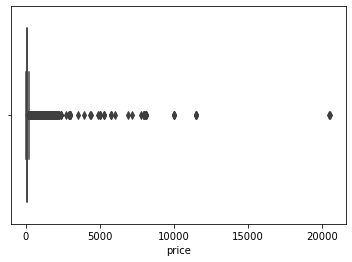

In [11]:
sns.boxplot(df['price'])

C:\Users\mesha\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='price'>

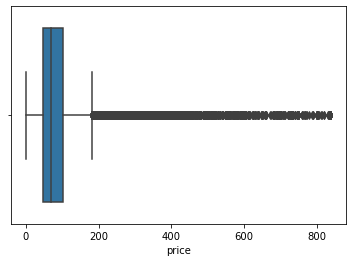

In [12]:
#Removing Outliers

upper_limit = df['price'].mean() + 3*df['price'].std()
lower_limit = df['price'].mean() - 3*df['price'].std()

df['price'] = np.where(
    df['price']>upper_limit,
    upper_limit,
    np.where(
        df['price']<lower_limit,
        lower_limit,
        df['price']
    )
)
sns.boxplot(df['price'])

In [13]:
#visualsing the data on a map
fig = px.scatter_mapbox(data_frame=df, lat = "latitude", lon = "longitude",
                        hover_name="room_type",hover_data=["price",
                        'beds','bathrooms','accommodates','amenities','review_scores_value'],
                        color="room_type",
                        color_continuous_scale=px.colors.cyclical, 
                        size_max=20, zoom=10,height=300
                       ,mapbox_style="carto-positron")

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [14]:
# visualising the mean price of each neighborhood
plot_df=df.groupby(['neighbourhood_group_cleansed'])['price'].agg('mean').reset_index()

fig = px.sunburst(plot_df, path=['neighbourhood_group_cleansed','price'],
                 color_discrete_map={'(?)':'black', 'India':'gold', 'China':'darkblue'})
fig.show()

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [15]:
# visualising the mean price of each room type
plot_df=df.groupby(['room_type'])['price'].agg('mean').reset_index()

fig = px.sunburst(plot_df, path=['room_type','price'],
                 color_discrete_map={'(?)':'black', 'India':'gold', 'China':'darkblue'})
fig.show()

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [16]:
# visualising the mean price based on the number of bedrooms
plot_df=df.groupby(['bedrooms'])['price'].agg('mean').reset_index()

fig = px.sunburst(plot_df, path=['bedrooms','price'],
                 color_discrete_map={'(?)':'black', 'India':'gold', 'China':'darkblue'})
fig.show()

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [17]:
# visualising the mean price based on the number of bathrooms
plot_df=df.groupby(['bathrooms'])['price'].agg('mean').reset_index()

fig = px.sunburst(plot_df, path=['bathrooms','price'],
                 color_discrete_map={'(?)':'black', 'India':'gold', 'China':'darkblue'})
fig.show()

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [18]:
plot_df=df.groupby(['neighbourhood_group_cleansed','room_type'])['price'].agg('mean').reset_index()
fig = px.treemap(plot_df, path=['room_type','neighbourhood_group_cleansed','price'], color='neighbourhood_group_cleansed'
                 ,color_discrete_map={'(?)':'black', 'India':'gold', 'China':'darkblue'},width=1000,height=800)
fig.show()

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\mesha\anaconda3\lib\site-packages\plotly\express\_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



array([[<AxesSubplot:title={'center':'latitude'}>,
        <AxesSubplot:title={'center':'longitude'}>,
        <AxesSubplot:title={'center':'accommodates'}>,
        <AxesSubplot:title={'center':'bedrooms'}>,
        <AxesSubplot:title={'center':'beds'}>],
       [<AxesSubplot:title={'center':'amenities'}>,
        <AxesSubplot:title={'center':'price'}>,
        <AxesSubplot:title={'center':'has_availability'}>,
        <AxesSubplot:title={'center':'availability_30'}>,
        <AxesSubplot:title={'center':'availability_60'}>],
       [<AxesSubplot:title={'center':'availability_90'}>,
        <AxesSubplot:title={'center':'availability_365'}>,
        <AxesSubplot:title={'center':'number_of_reviews'}>,
        <AxesSubplot:title={'center':'number_of_reviews_ltm'}>,
        <AxesSubplot:title={'center':'number_of_reviews_l30d'}>],
       [<AxesSubplot:title={'center':'review_scores_rating'}>,
        <AxesSubplot:title={'center':'review_scores_accuracy'}>,
        <AxesSubplot:title={'cen

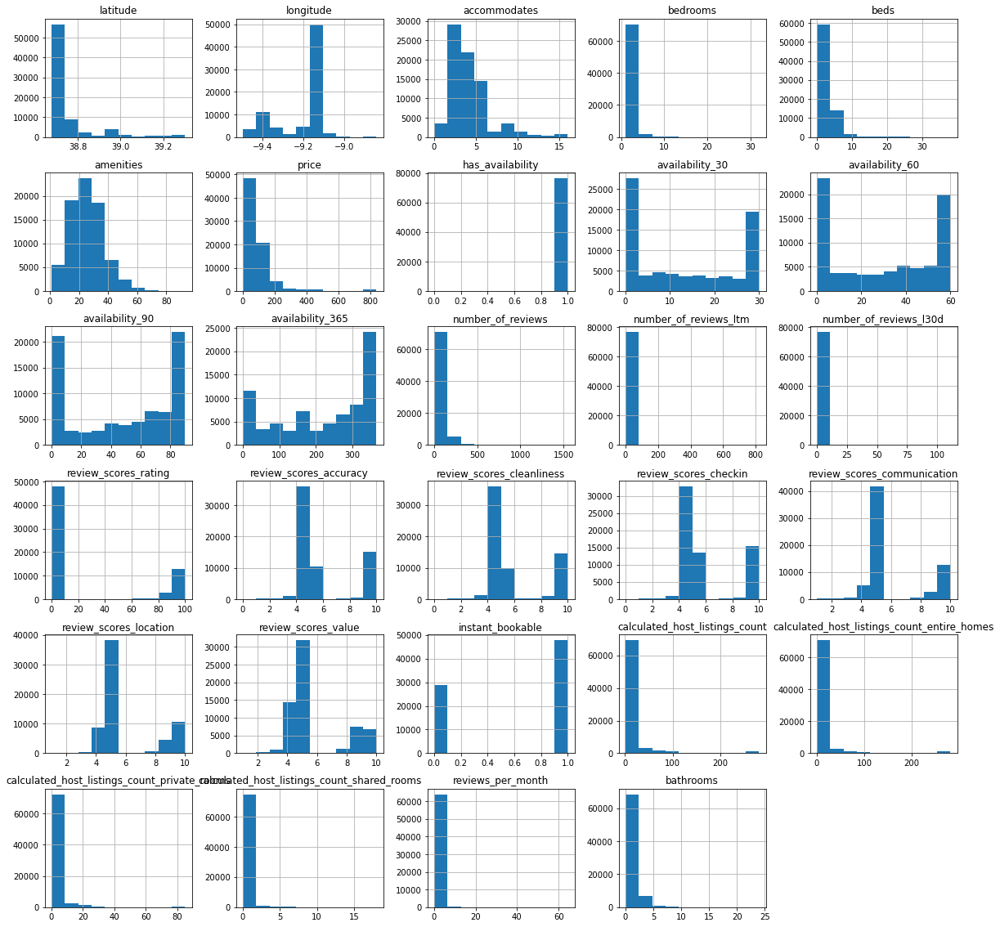

In [19]:
df.hist(figsize=(20,20))

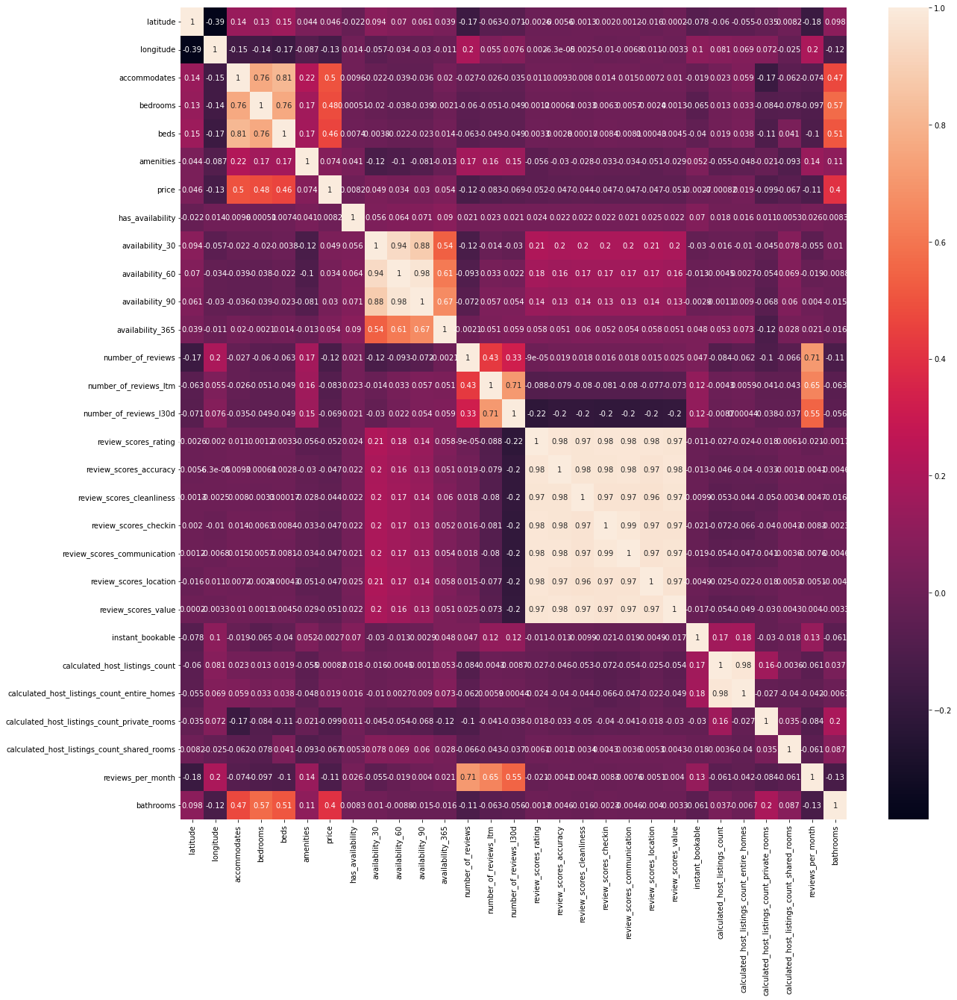

In [20]:
corrMatrix = df.corr()
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corrMatrix,annot=True)
plt.show()

# REGRESSION TO PREDIC THE PRICES

In [23]:
#Train Test Split
X = df.drop(['price'], axis=1)
y=df['price']

X_train,X_test,y_train,y_test = train_test_split(X,y, test_size=0.1, random_state=1)

In [24]:
numeric_features = X.select_dtypes('number').columns
categorical_features =X.select_dtypes('object').columns

In [25]:
numeric_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="mean")), 
           ("scaler", StandardScaler())])

categorical_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="constant", fill_value="missing")),
           ("onehot", OneHotEncoder(handle_unknown="ignore"))])

col_transformer = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer, numeric_features),
        ("categorical", categorical_transformer, categorical_features)],remainder='passthrough')

In [27]:
ols = Pipeline(
    steps=[
        ("preprocessor", col_transformer),
        ("regressor",LinearRegression())])

ridge = Pipeline(
    steps=[
        ("preprocessor", col_transformer),
        ("regressor",Ridge())])

lasso = Pipeline(
    steps=[
        ("preprocessor", col_transformer),
        ("regressor",Lasso())])

In [29]:
LinearReg = cross_val_score(ols, X_train, y_train , cv=3)
print("Linear Regression ",LinearReg.mean())

Rid = cross_val_score(ridge, X_train, y_train , cv=3)
print("Ridge             ",Rid.mean())

Las = cross_val_score(lasso, X_train, y_train , cv=3)
print("Lasso             ",Las.mean())

Linear Regression  0.36729818117708274
Ridge              0.3676487819115336
Lasso              0.33313131981444644


In [31]:
#Gridsearch of Lasso and Ridge
param = {  'regressor__alpha'         :  [0.0001 , 0.001 , 0.01 , 0.1 , 1 , 10] }
 
grid_Ridge = GridSearchCV(ridge,param,cv=3,scoring='r2').fit(X_train, y_train)
grid_Lasso = GridSearchCV(lasso,param,cv=3,scoring='r2').fit(X_train, y_train)

C:\Users\mesha\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:609: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 147246338.89107335, tolerance: 48002.18635413248

C:\Users\mesha\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:609: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 148017080.91980824, tolerance: 48374.41420475638

C:\Users\mesha\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:609: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 150841011.5052885, tolerance: 48919.218296167564

C:\Users\mesha\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:609: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 117699179.55340719, to

In [32]:
print(grid_Ridge.best_params_,
      "\n    Score:%0.2f" %(100*grid_Ridge.best_score_))

print(grid_Lasso.best_params_,
      "\n    Score:%0.2f" %(100*grid_Lasso.best_score_))

{'regressor__alpha': 0.01} 
    Score:36.84
{'regressor__alpha': 0.01} 
    Score:36.80


In [76]:
#Prepraring for Random Forest Regressor
df_cat = pd.get_dummies(df)
df_cat.fillna(df_cat.mean(), inplace=True)


latitude                     0
longitude                    0
accommodates                 0
bedrooms                     0
beds                         0
                            ..
property_type_Yurt           0
room_type_Entire home/apt    0
room_type_Hotel room         0
room_type_Private room       0
room_type_Shared room        0
Length: 155, dtype: int64

In [77]:

X = df_cat.drop(['price'], axis=1)
y=df_cat['price']

numeric_features = X.select_dtypes('number').columns
categorical_features =X.select_dtypes('object').columns

X_train,X_test,y_train,y_test = train_test_split(X,y, test_size=0.1, random_state=1)
 
rfr = RandomForestRegressor()
xgbr =XGBRegressor()

In [79]:
#Hyperparameter Tuning of Random Forest Regressor

param = { 'n_estimators'  : [50, 100 ,200],
          'max_depth'     : [ 5, 10, 15],
          'max_features' : ["auto", "sqrt", "log2"]}

rfr_grid=GridSearchCV(rfr,param,cv=3).fit(X_train,y_train)

In [80]:
#Hyperparameter Tuning of  XGBoostRegression

param = { 'n_estimators'  : [10, 50 ,100],
          'max_depth'     : [ 5, 10, 15],
          'learning_rate' : [0.05,0.1, 0.15, 0.20]}

xgbr_grid=GridSearchCV(xgbr,param,cv=3).fit(X_train,y_train)

In [81]:
#Hyperparameter Tuning results
print(rfr)
print(rfr_grid.best_params_,
      "\n    Score:%0.2f" %(100*rfr_grid.best_score_))

print(xgbr)
print(xgbr_grid.best_params_,
      "\n    Score:%0.2f" %(100*xgbr_grid.best_score_))

RandomForestRegressor()
{'max_depth': 15, 'max_features': 'auto', 'n_estimators': 200} 
    Score:67.12
XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)
{'learning_rate': 0.15, 'max_depth': 15, 'n_estimators': 100} 
    Score:72.49


In [86]:
#Final Random Forest Regressor model
rfr =RandomForestRegressor(n_estimators=200 
                           ,max_depth=15 
                           ,max_features='auto' )

rfr.fit(X_train,y_train)

RandomForestRegressor(max_depth=15, n_estimators=200)

In [87]:
rfr_y_pred = rfr.predict(X_test)
rfr_R2=r2_score(y_test, rfr_y_pred)
rfr_MSE=mean_squared_error(y_test, rfr_y_pred)
rfr_MAE=mean_absolute_error(y_test, rfr_y_pred)
print("R2 = ",rfr_R2,"\nMSE = ",rfr_MSE,"\nMAE = ",rfr_MAE)

R2 =  0.7482500527501008 
MSE =  2585.3359744656964 
MAE =  27.34863570351332


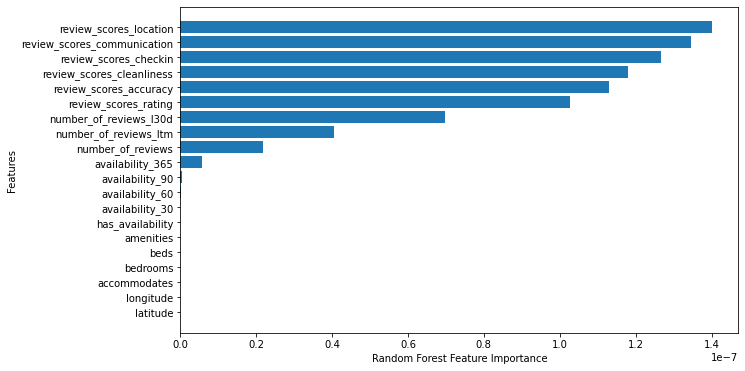

In [209]:
#Random Forest feature importance 
plt.figure(figsize=(10,6))
n=20
sorted_idx =rfr.feature_importances_.argsort()
plt.barh(X_train.columns[:n],  rfr.feature_importances_[sorted_idx][:n])
plt.xlabel("Random Forest Feature Importance")
plt.ylabel("Features")

plt.show()

In [82]:
#final xgbregressor model 
xgbr =XGBRegressor(n_estimators=100
                   ,max_depth=15
                   ,learning_rate= 0.15)
xgbr.fit(X_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.15, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=15, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [83]:
#Evation of xgbregressor model 
xgbr_y_pred = xgbr.predict(X_test)
xgbr_R2=r2_score(y_test, xgbr_y_pred)
xgbr_MSE=mean_squared_error(y_test, xgbr_y_pred)
xgbr_MAE=mean_absolute_error(y_test, xgbr_y_pred)
print("R2 = ",xgbr_R2,"\nMSE = ",xgbr_MSE,"\nMAE = ",xgbr_MAE)

R2 =  0.8093283588067086 
MSE =  1958.0947629677369 
MAE =  21.26253354716201


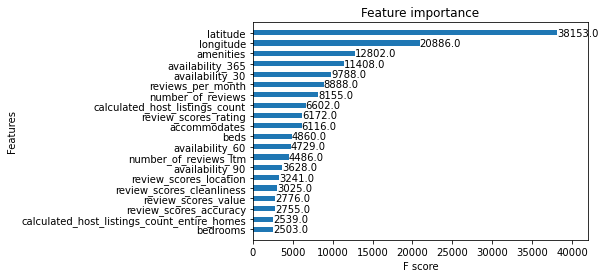

In [208]:
# Top 20 features of xgbregressor model 
plot_importance(xgbr, max_num_features=20,grid=False,height=0.5)
plt.show()

# CLASSIFICATION TO CLASSIFY THE REVIEW RATE 

In [13]:
dfCopy = df.copy()

In [14]:
dfCopy.head()

,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,...,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms
0,Lisboa,38.69750,-9.19768,Entire rental unit,Entire home/apt,4,1.0,1.0,36,40.0,...,4.97,4.81,4.52,1,1,1,0,0,0.36,1.0
1,Lisboa,38.71241,-9.12706,Entire rental unit,Entire home/apt,3,1.0,1.0,27,50.0,...,4.97,4.88,4.82,1,1,1,0,0,1.37,1.0
2,Lisboa,38.71082,-9.12719,Entire rental unit,Entire home/apt,4,1.0,2.0,18,60.0,...,4.74,4.82,4.61,1,1,1,0,0,2.53,1.0
3,Lisboa,38.71156,-9.12987,Entire rental unit,Entire home/apt,4,1.0,1.0,26,60.0,...,4.91,4.88,4.75,1,1,1,0,0,2.57,1.0
4,Lisboa,38.71108,-9.15979,Entire rental unit,Entire home/apt,16,9.0,13.0,32,957.0,...,4.97,4.83,4.60,0,2,2,0,0,0.48,8.0


In [15]:
dfCopy['review_scores_value'].unique()                          

array([ 4.52,  4.82,  4.61,  4.75,  4.6 ,  4.72,  4.5 ,  4.43,  4.12,
        4.88,  4.78,  4.83,  4.55,   nan,  4.63,  4.37,  4.85,  4.46,
        4.66,  4.32,  4.64,  4.73,  4.81,  4.42,  5.  ,  4.71,  4.7 ,
        4.47,  4.  ,  4.74,  4.17,  4.94,  4.9 ,  4.8 ,  4.44,  4.86,
        4.69,  4.51,  4.31,  4.57,  4.79,  4.89,  4.45,  4.84,  4.68,
        4.41,  4.11,  4.34,  4.77,  4.4 ,  4.16,  4.29,  4.67,  4.58,
        3.67,  3.78,  4.65,  4.25,  4.53,  3.6 ,  4.18,  4.76,  4.92,
        4.49,  3.25,  4.87,  4.36,  4.2 ,  4.59,  4.54,  4.48,  4.62,
        4.38,  4.56,  4.33,  3.94,  4.93,  4.09,  4.06,  4.3 ,  4.27,
        3.  ,  4.91,  4.14,  4.13,  4.15,  4.24,  3.75,  4.95,  4.35,
        3.88,  1.  ,  4.23,  4.97,  3.92,  2.89,  3.43,  4.39,  4.22,
        3.5 ,  4.96,  3.33,  3.57,  3.86,  4.19,  3.85,  2.71,  4.26,
        2.67,  4.1 ,  4.21,  3.8 ,  4.08,  3.73,  4.28,  4.05,  3.71,
        3.95,  3.87,  4.98,  2.  ,  2.75,  3.89,  3.83,  4.04,  2.5 ,
        3.91,  3.2 ,

In [16]:
# Create the new column contain binary classification low and high

def review_ratingColumn(review):
    replace=[]
    for value in review:
        if value>=3.5:
            replace.append(1)
        else:
            replace.append(0)
    return replace
    
dfCopy['review_rating']=review_ratingColumn(dfCopy['review_scores_rating'])

In [17]:
dfCopy['review_rating'].unique()                          

array([1, 0], dtype=int64)

In [18]:
dfCopy['review_rating'].value_counts()

1    62828
0    13888
Name: review_rating, dtype: int64

C:\Users\hopel\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


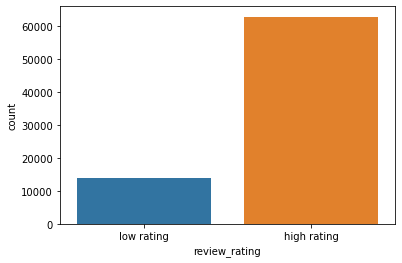

In [19]:
g = sns.countplot(dfCopy['review_rating'])
g.set_xticklabels(['low rating','high rating'])
plt.show()

In [20]:
from sklearn.utils import resample
#create two different dataframe of majority and minority class 
df_majority = dfCopy[(dfCopy['review_rating']==0)] 
df_minority = dfCopy[(dfCopy['review_rating']==1)] 
# Undersample minority class
df_minority_Undersampled = resample(df_minority, 
                                 replace=True,    # sample with replacement
                                 n_samples= 13888, # to match majority class
                                 random_state=42)  # reproducible results
# Combine majority class with Undersampled minority class
df_Undersampled = pd.concat([df_minority_Undersampled, df_majority])

C:\Users\hopel\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


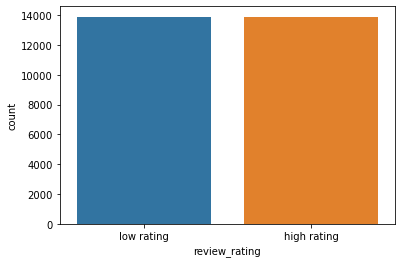

In [21]:
g = sns.countplot(df_Undersampled['review_rating'])
g.set_xticklabels(['low rating','high rating'])
plt.show()

In [22]:
df_Undersampled['review_rating'].value_counts()

1    13888
0    13888
Name: review_rating, dtype: int64

In [23]:
df_Undersampled.head()

,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,...,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms,review_rating
10007,Lisboa,38.71616,-9.12416,Entire residential home,Entire home/apt,9,4.0,5.0,32,193.0,...,4.84,4.73,0,7,7,0,0,4.08,2.0,1
182,Lisboa,38.71147,-9.13382,Entire loft,Entire home/apt,3,NaN,2.0,32,56.0,...,4.91,4.68,0,2,2,0,0,1.34,1.0,1
911,Cascais,38.70089,-9.44684,Entire rental unit,Entire home/apt,6,2.0,NaN,26,100.0,...,4.44,4.44,0,1,1,0,0,0.10,2.0,1
7601,Lisboa,38.71228,-9.12948,Entire apartment,Entire home/apt,2,NaN,1.0,16,69.0,...,9.00,8.00,1,43,43,0,0,0.17,1.0,1
18382,Vila Franca De Xira,38.95450,-8.98770,Private room in condominium (condo),Private room,2,1.0,1.0,36,26.0,...,3.67,3.67,1,5,0,5,0,1.55,2.0,1


In [24]:
X = df_Undersampled.drop('review_rating',axis=1)
X

,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,amenities,price,...,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,bathrooms
10007,Lisboa,38.716160,-9.124160,Entire residential home,Entire home/apt,9,4.0,5.0,32,193.0,...,4.97,4.84,4.73,0,7,7,0,0,4.08,2.0
182,Lisboa,38.711470,-9.133820,Entire loft,Entire home/apt,3,NaN,2.0,32,56.0,...,4.86,4.91,4.68,0,2,2,0,0,1.34,1.0
911,Cascais,38.700890,-9.446840,Entire rental unit,Entire home/apt,6,2.0,NaN,26,100.0,...,4.44,4.44,4.44,0,1,1,0,0,0.10,2.0
7601,Lisboa,38.712280,-9.129480,Entire apartment,Entire home/apt,2,NaN,1.0,16,69.0,...,9.00,9.00,8.00,1,43,43,0,0,0.17,1.0
18382,Vila Franca De Xira,38.954500,-8.987700,Private room in condominium (condo),Private room,2,1.0,1.0,36,26.0,...,3.67,3.67,3.67,1,5,0,5,0,1.55,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19100,Lisboa,38.715570,-9.148660,Private room in casa particular,Private room,1,NaN,1.0,8,40.0,...,NaN,NaN,NaN,0,2,0,2,0,NaN,1.0
19101,Lisboa,38.733500,-9.142750,Private room in rental unit,Private room,2,1.0,1.0,3,31.0,...,NaN,NaN,NaN,1,3,1,2,0,NaN,1.0
19102,Mafra,38.960421,-9.416212,Entire condominium (condo),Entire home/apt,4,2.0,2.0,18,200.0,...,NaN,NaN,NaN,0,1,1,0,0,NaN,2.0
19103,Lisboa,38.711954,-9.135315,Entire rental unit,Entire home/apt,3,1.0,0.0,17,80.0,...,NaN,NaN,NaN,1,5,5,0,0,NaN,1.0


In [25]:
# assign target to y
y = df_Undersampled['review_rating']
y

10007    1
182      1
911      1
7601     1
18382    1
        ..
19100    0
19101    0
19102    0
19103    0
19104    0
Name: review_rating, Length: 27776, dtype: int64

In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1/3, random_state=0)    

In [27]:
categorical_features = X_train.select_dtypes('object').columns
numeric_features = X_train.select_dtypes('number').columns

In [28]:
# pipline contain SimpleImputer and OneHotEncoder to deal categorical variables 
categorical_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="constant", fill_value="missing")),
           ("onehot", OneHotEncoder(handle_unknown="ignore"))]
)

In [29]:
# numric transformer StandardScaler and SimpleImputer
numeric_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="mean")), 
           ("scaler", StandardScaler())]
)

In [30]:
# fit_transform or transform. The output of this step is a set of categorical variable and numric variable

col_transformer = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer, numeric_features),
        ("categorical", categorical_transformer, categorical_features)
    ],
    remainder='passthrough'
)

In [31]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import TruncatedSVD
from sklearn.svm import SVC
from sklearn.decomposition import PCA


In [32]:
# Appliy the PCA on traing set
X_train_scaled = col_transformer.fit_transform(X_train)
pca = TruncatedSVD(n_components =2)
X_pca = pca.fit_transform(X_train_scaled)

In [33]:
# show the data frame of PCA
df_pca = pd.DataFrame(
    X_pca,
    columns=['PC1','PC2'])
df_pca.head()

,PC1,PC2
0,-0.144290,-1.825986
1,-6.124546,3.109475
2,1.881858,1.438934
3,-0.329007,-0.886967
4,1.854416,2.380818


Text(0, 0.5, 'Second Principal Component')

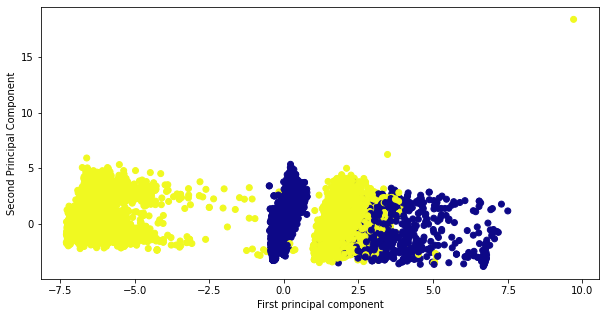

In [34]:
#plot PCA
plt.figure(figsize=(10,5))
plt.scatter(X_pca[:,0],X_pca[:,1],c=y_train,cmap='plasma')
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component')

In [35]:
# RandomForestClassifier  
model1 = Pipeline(
    steps=[
        ("preprocessor", col_transformer),
        ('pca', TruncatedSVD(n_components=2)), 
        ("rfc",RandomForestClassifier())])

In [36]:
RandomForestClassifier = cross_val_score(model1, X_train, y_train , cv=5)
print("RandomForestClassifierScore",RandomForestClassifier.mean())

RandomForestClassifierScore 0.9883891206067814


In [37]:
model1.fit(X_train,y_train)
y_pred = model1.predict(X_test)
y_pred

array([0, 0, 1, ..., 0, 1, 1], dtype=int64)

In [38]:
from sklearn.metrics import confusion_matrix, accuracy_score

In [39]:
# Evaluating RandomForestClassifier
cm = confusion_matrix(y_test, y_pred)
print(cm)

[[4612   46]
 [  47 4554]]


In [40]:
accuracy_score(y_test, y_pred)

0.9899557187601253

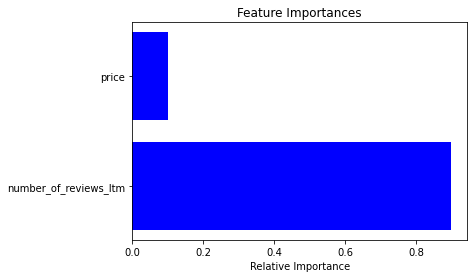

In [41]:
# plot  feature importances Randome forest with PCA  
model=model1.steps[1][1]
n_pcs= model.components_.shape[0]
initial_feature_names = X_train.columns
most_important = [np.abs(model.components_[i]).argmax() for i in range(n_pcs)]
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]
zipped_feats = zip(most_important_names, model1.steps[2][1].feature_importances_)
zipped_feats = sorted(zipped_feats, key=lambda x: x[1], reverse=True)

features, importances = zip(*zipped_feats)


plt.title('Feature Importances')
plt.barh(range(len(importances)), importances, color='b' , align='center')
plt.yticks(range(len(importances)), features)
plt.xlabel('Relative Importance')
plt.show()

In [42]:
#SVM models
model2 = Pipeline(
    steps=[
        ("preprocessor", col_transformer),
        ('pca', TruncatedSVD(n_components=2)), 
        ("SVM",SVC(kernel='rbf', gamma=0.5, C=0.1))])

In [43]:
SVCScores = cross_val_score(model2, X_train, y_train , cv=5)
print('SVCScores',SVCScores.mean())

SVCScores 0.9872550800850867


In [44]:
model2.fit(X_train,y_train)
y_pred = model2.predict(X_test)
y_pred

array([0, 0, 1, ..., 0, 1, 1], dtype=int64)

In [45]:
# Evaluating SVM model 
cm2 = confusion_matrix(y_test, y_pred)
print(cm2)

[[4607   51]
 [  42 4559]]


In [46]:
accuracy_score(y_test, y_pred)

0.9899557187601253